# Run STitch3D on the Drosophila embryo dataset

In this tutorial, we show STitch3D's analysis of the Drosophila embryo dataset.

The Drosophila embryo Stereo-seq dataset is publicly available at (https://db.cngb.org/stomics/flysta3d/download.html. The Drosophila embryo sci-RNA-seq dataset is publicly available at https://www.ncbi.nlm.nih.gov/geo/query/acc.cgi?acc=GSE190149.

## Import packages

In [1]:
import pandas as pd
import numpy as np
import scanpy as sc
import anndata as ad
from scipy.io import mmread
import os
import sys

import STitch3D

import warnings
warnings.filterwarnings("ignore")

os.environ["CUDA_VISIBLE_DEVICES"] = "5"

## Preprocessing

### Load datasets

Load single-cell reference dataset:

In [2]:
ref_count = mmread("./data/Calderon_2022/GSE190147_scirnaseq_gene_matrix.mtx")
ref_row = pd.read_csv("./data/Calderon_2022/GSE190147_scirnaseq_gene_matrix.rows.txt",
                      header=None, index_col=0)
ref_col = pd.read_csv("./data/Calderon_2022/GSE190147_scirnaseq_gene_matrix.columns.txt",
                      index_col=0, sep='\t')

adata_ref_raw = ad.AnnData(X=ref_count.tocsr().T)
adata_ref_raw.obs = ref_col
adata_ref_raw.var.index = [str(i) for i in list(ref_row.index)]

In [3]:
adata_ref = ad.AnnData(X=adata_ref_raw.X)
adata_ref.obs = adata_ref_raw.obs
adata_ref.var = adata_ref_raw.var

adata_ref = adata_ref[adata_ref.obs['time'] == 'hrs_16_20']
adata_ref.obs.rename(columns = {'exp': 'exp_idx'}, inplace = True)

clust = pd.read_csv("./data/Calderon_2022/seurat_clust_1620.txt", sep=" ")
clust.index = clust.barcode.values.astype(str)
clust = clust.loc[adata_ref.obs.index, :]
adata_ref.obs["seurat_clust"] = clust.clust.values.astype(str)

#transfer clusters to cell type annotations
anno_table = pd.read_csv("./data/Calderon_2022/cluster_anno_table.csv")

adata_ref.obs['celltype'] = adata_ref.obs['seurat_clust'].values.astype(str)
for i in range(anno_table.shape[0]):
    adata_ref.obs['celltype'] = adata_ref.obs['celltype'].replace(anno_table["cluster"][i].astype(str),
                                                                  anno_table["annotation"][i])
    
adata_ref = adata_ref[(adata_ref.obs['celltype'] != "lowq") & (adata_ref.obs['celltype'] != "unk"), :]
clust = clust.loc[adata_ref.obs.index, :]

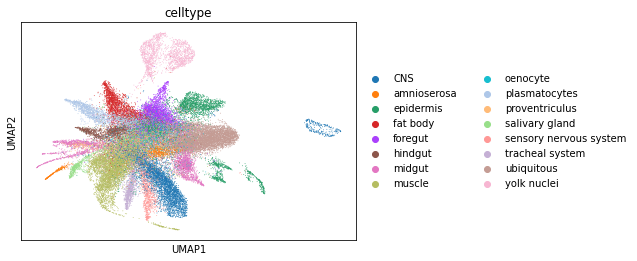

In [4]:
#plot umap
adata_ref_umap = adata_ref.copy()
hvg_num = 2000
sc.pp.highly_variable_genes(adata_ref_umap, flavor='seurat_v3', n_top_genes=hvg_num)
sc.pp.normalize_total(adata_ref_umap, target_sum=1e4)
sc.pp.log1p(adata_ref_umap)
sc.pp.scale(adata_ref_umap, max_value=10)
sc.tl.pca(adata_ref_umap, n_comps=30, svd_solver='arpack')
sc.pp.neighbors(adata_ref_umap, n_pcs=30)
sc.tl.umap(adata_ref_umap)
sc.pl.umap(adata_ref_umap, color=['celltype'])

Load spatial transcriptomics datasets:

In [5]:
#spatial data
adata_st_raw = sc.read_h5ad("./data/stereoseq_data/E16-18h_a_count_normal_stereoseq.h5ad")
adata_st_raw.X = adata_st_raw.layers['raw_counts']

slice_all = sorted(list(set(adata_st_raw.obs['slice_ID'].values)))[:-1]

adata_st_list_raw = []
for slice_id in slice_all:
    adata_st_i = adata_st_raw[adata_st_raw.obs['slice_ID'].values == slice_id]
    adata_st_i.obsm['spatial'] = np.concatenate((adata_st_i.obs['raw_x'].values.reshape(-1, 1), 
                                                 adata_st_i.obs['raw_y'].values.reshape(-1, 1)), axis=1) / 20
    adata_st_i.obsm['loc_use'] = np.concatenate((adata_st_i.obs['raw_x'].values.reshape(-1, 1), 
                                                 adata_st_i.obs['raw_y'].values.reshape(-1, 1)), axis=1) / 20
    adata_st_i.obsm['coor_3d'] = np.concatenate((adata_st_i.obs['new_x'].values.reshape(-1, 1), 
                                                 adata_st_i.obs['new_y'].values.reshape(-1, 1),
                                                 adata_st_i.obs['new_z'].values.reshape(-1, 1)), axis=1)
    adata_st_i.obs['array_row'] = adata_st_i.obs['raw_y'].values
    adata_st_i.obs['array_col'] = adata_st_i.obs['raw_x'].values
    
    adata_st_list_raw.append(adata_st_i.copy())

### Alignment of ST tissue slices

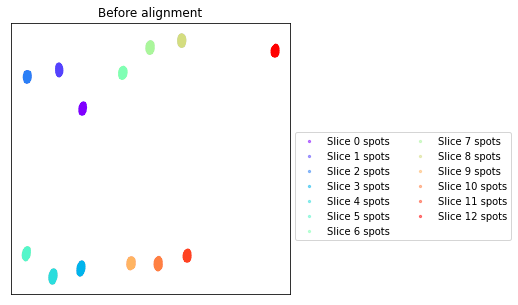

Using PASTE algorithm for alignemnt.
Aligning spots...


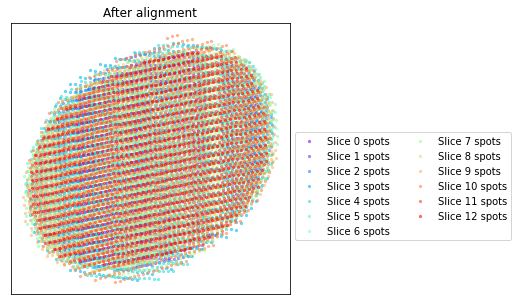

In [6]:
adata_st_list = STitch3D.utils.align_spots(adata_st_list_raw, data_type="ST", coor_key="loc_use", 
                                           method='paste', plot=True, paste_alpha=0.2)

### Selecting highly variable genes and building 3D spatial graph

In [7]:
adata_st, adata_basis = STitch3D.utils.preprocess(adata_st_list, 
                                                  adata_ref,
                                                  celltype_ref_col="celltype",
                                                  sample_col="exp_idx",
                                                  n_hvg_group=500,
                                                  slice_dist_micron=[1.]*(len(adata_st_list)-1),
                                                  c2c_dist=1.)

Finding highly variable genes...
5841 highly variable genes selected.
Calculate basis for deconvolution...
3 batches are used for computing the basis vector of cell type <CNS>.
3 batches are used for computing the basis vector of cell type <amnioserosa>.
3 batches are used for computing the basis vector of cell type <epidermis>.
3 batches are used for computing the basis vector of cell type <fat body>.
3 batches are used for computing the basis vector of cell type <foregut>.
3 batches are used for computing the basis vector of cell type <hindgut>.
3 batches are used for computing the basis vector of cell type <midgut>.
3 batches are used for computing the basis vector of cell type <muscle>.
3 batches are used for computing the basis vector of cell type <oenocyte>.
3 batches are used for computing the basis vector of cell type <plasmatocytes>.
3 batches are used for computing the basis vector of cell type <proventriculus>.
3 batches are used for computing the basis vector of cell type <

## Running STitch3D model

In [8]:
model = STitch3D.model.Model(adata_st, adata_basis)

model.train()

  0%|          | 1/20000 [00:00<2:51:58,  1.94it/s]

Step: 0, Loss: 2598.5024, d_loss: 2593.4470, f_loss: 50.5535


 10%|█         | 2001/20000 [07:47<1:11:43,  4.18it/s]

Step: 2000, Loss: 36.1440, d_loss: 32.9456, f_loss: 31.9839


 20%|██        | 4001/20000 [15:34<1:03:42,  4.19it/s]

Step: 4000, Loss: -36.3654, d_loss: -39.5210, f_loss: 31.5559


 30%|███       | 6001/20000 [23:22<55:48,  4.18it/s]  

Step: 6000, Loss: -48.1733, d_loss: -51.2974, f_loss: 31.2414


 40%|████      | 8001/20000 [31:10<47:50,  4.18it/s]

Step: 8000, Loss: -49.2319, d_loss: -52.3387, f_loss: 31.0677


 50%|█████     | 10001/20000 [38:58<39:51,  4.18it/s]

Step: 10000, Loss: -49.9239, d_loss: -53.0185, f_loss: 30.9458


 60%|██████    | 12001/20000 [46:47<31:54,  4.18it/s]

Step: 12000, Loss: -50.1545, d_loss: -53.2404, f_loss: 30.8598


 70%|███████   | 14001/20000 [54:35<23:54,  4.18it/s]

Step: 14000, Loss: -50.2873, d_loss: -53.3653, f_loss: 30.7804


 80%|████████  | 16001/20000 [1:02:23<15:55,  4.18it/s]

Step: 16000, Loss: -50.3754, d_loss: -53.4456, f_loss: 30.7026


 90%|█████████ | 18001/20000 [1:10:11<07:58,  4.18it/s]

Step: 18000, Loss: -49.9656, d_loss: -53.0406, f_loss: 30.7503


100%|██████████| 20000/20000 [1:17:59<00:00,  4.27it/s]


In [9]:
save_path = "./results_Drosophila_embryo"

result = model.eval(adata_st_list_raw, save=True, output_path=save_path)

## Visualizing results in 2D

Slice 1


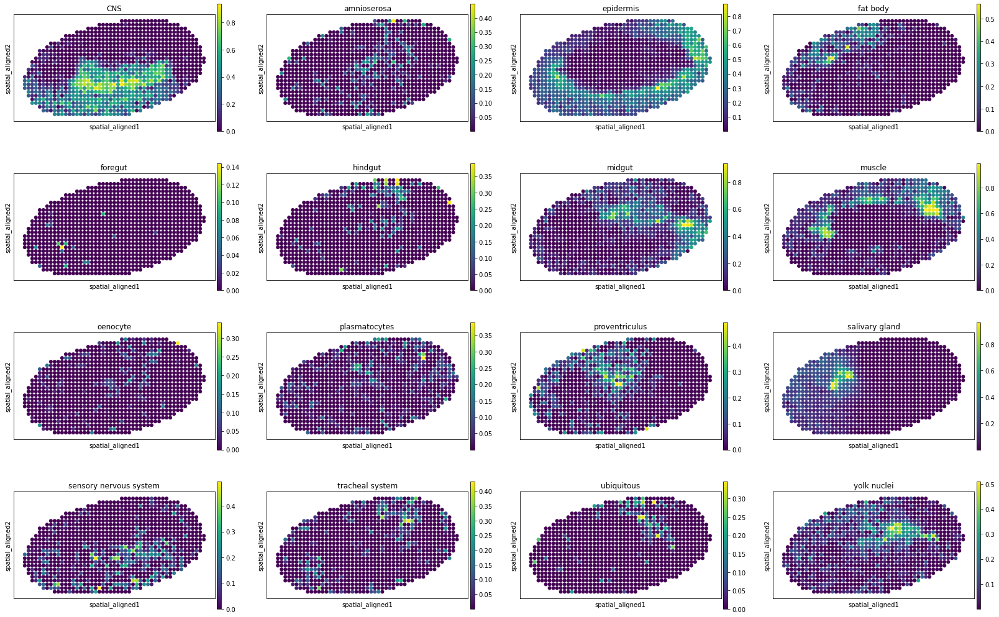

Slice 2


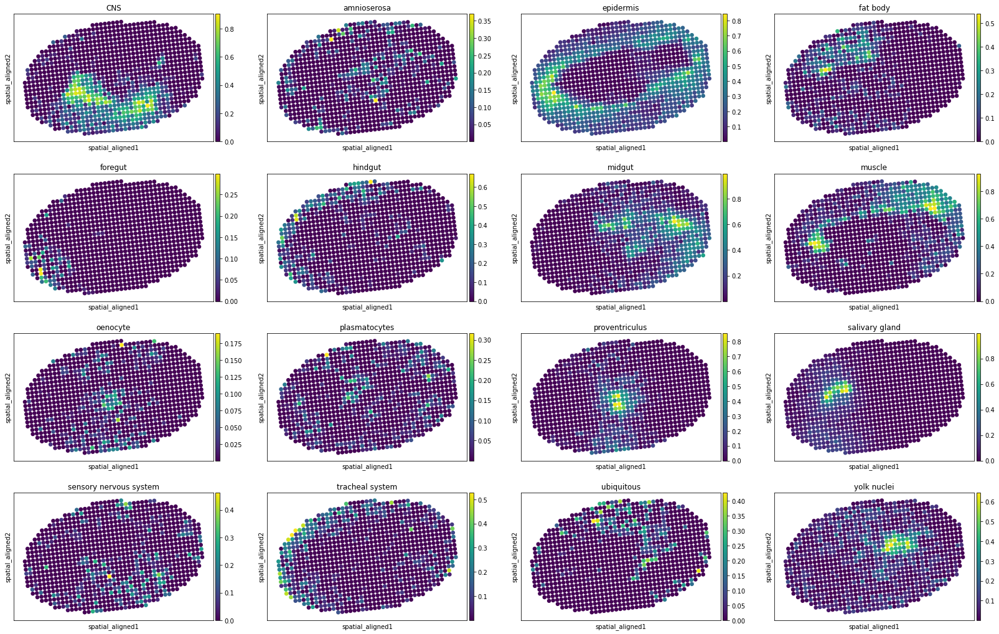

Slice 3


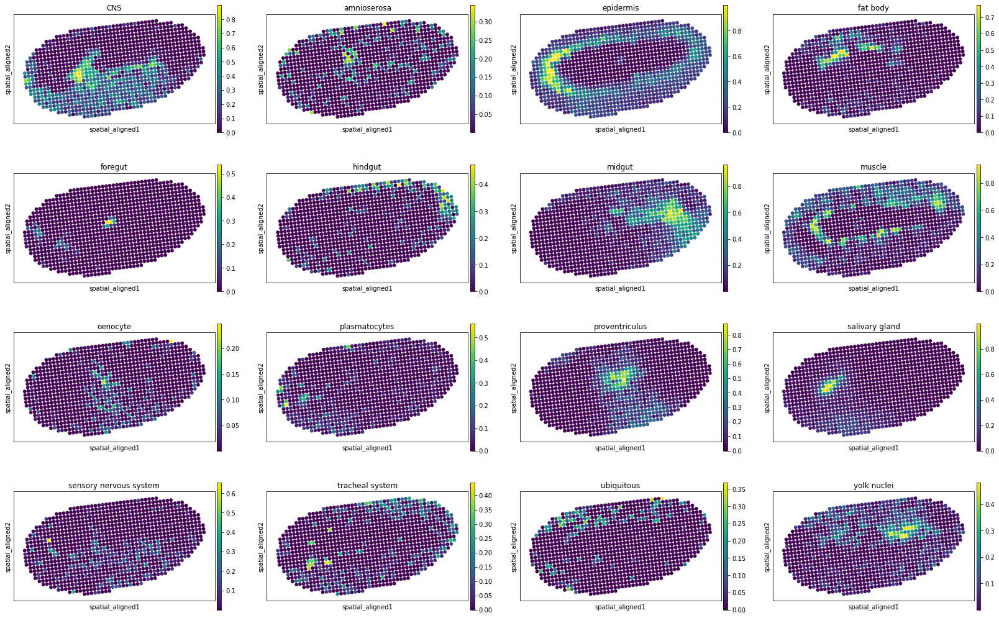

Slice 4


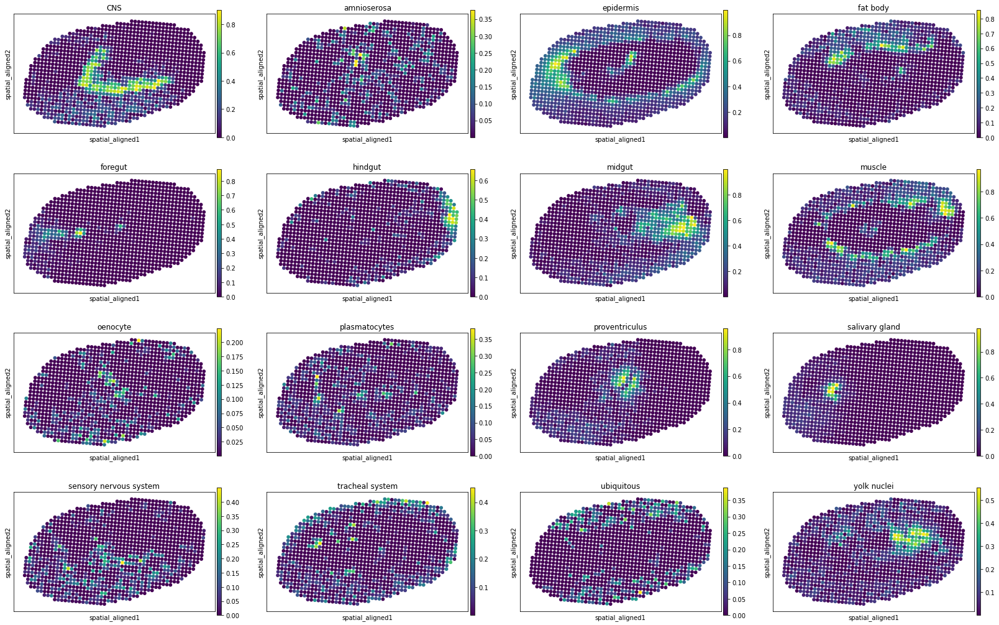

Slice 5


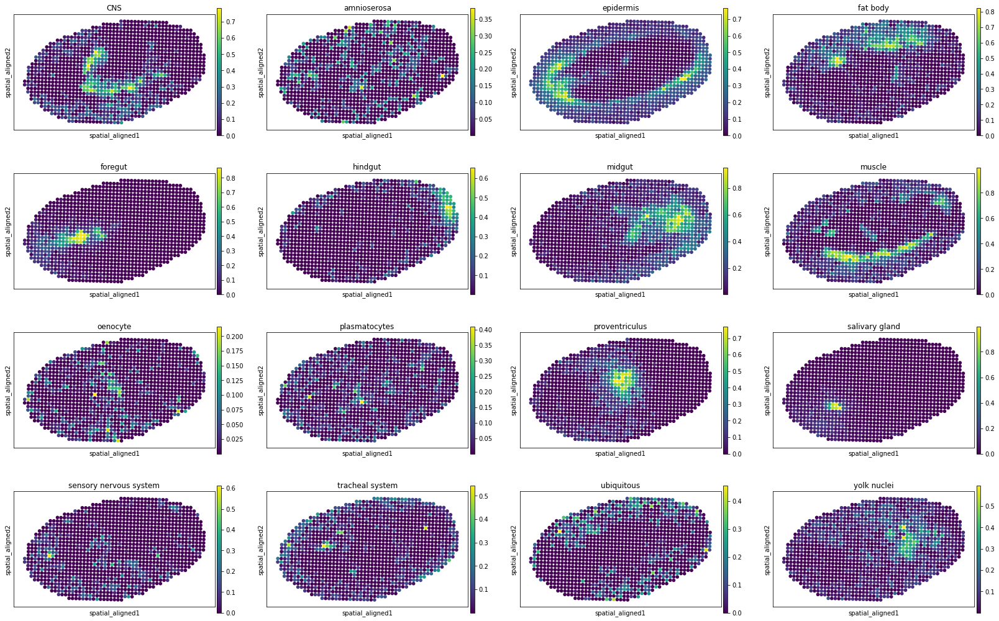

Slice 6


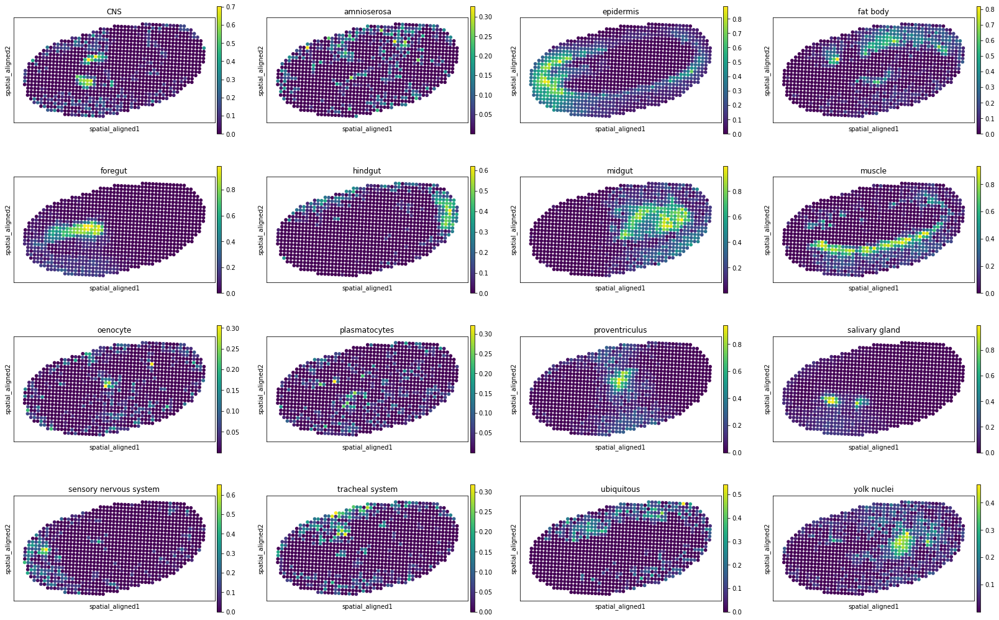

Slice 7


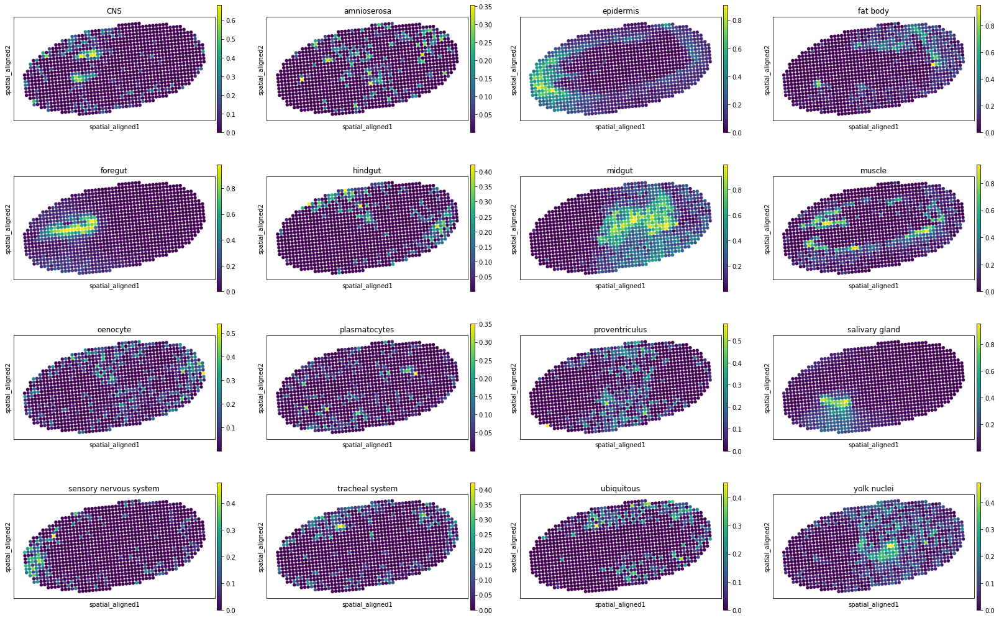

Slice 8


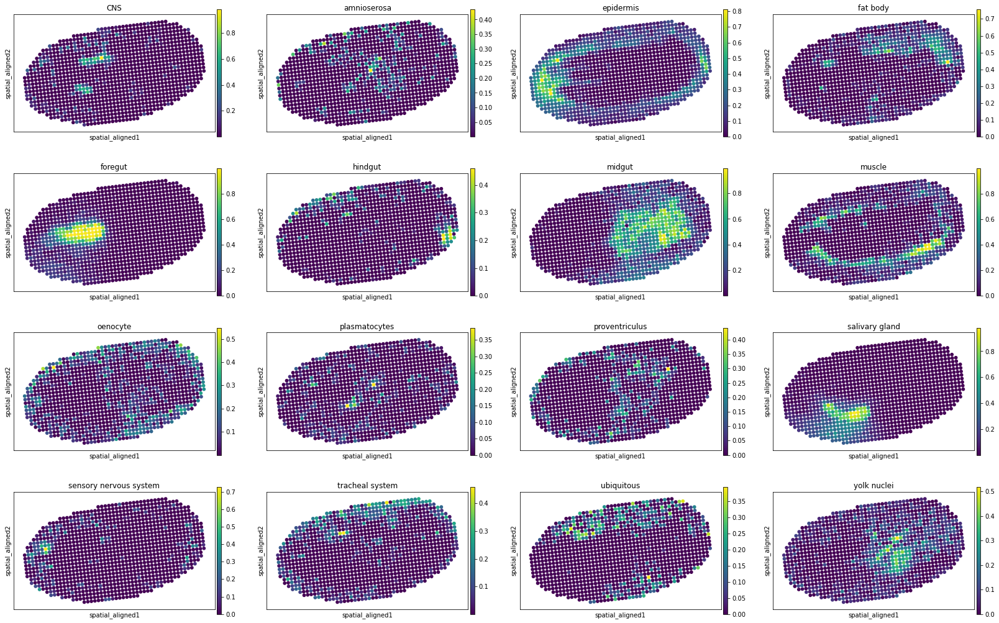

Slice 9


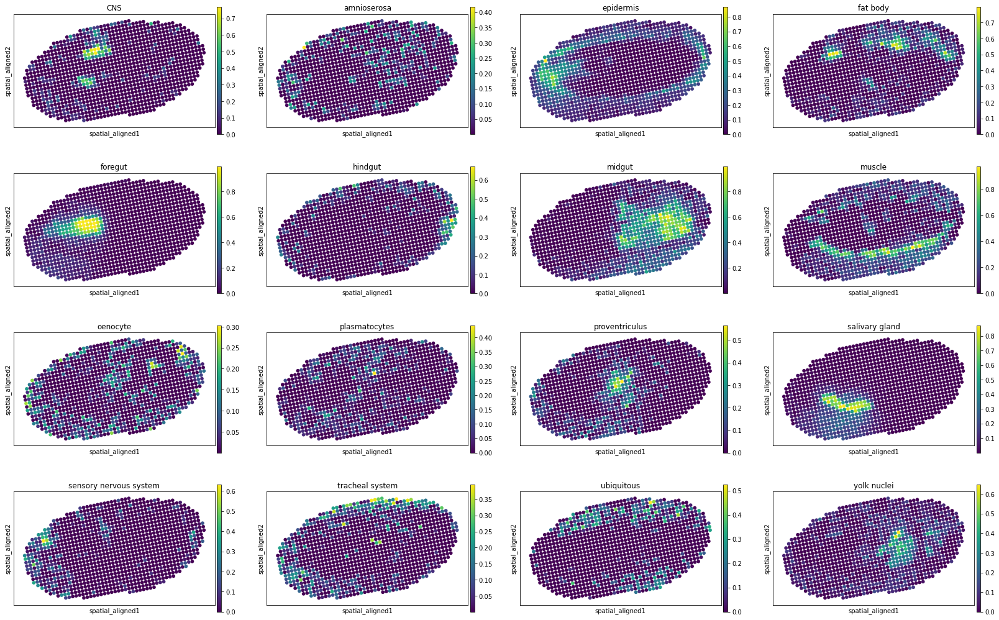

Slice 10


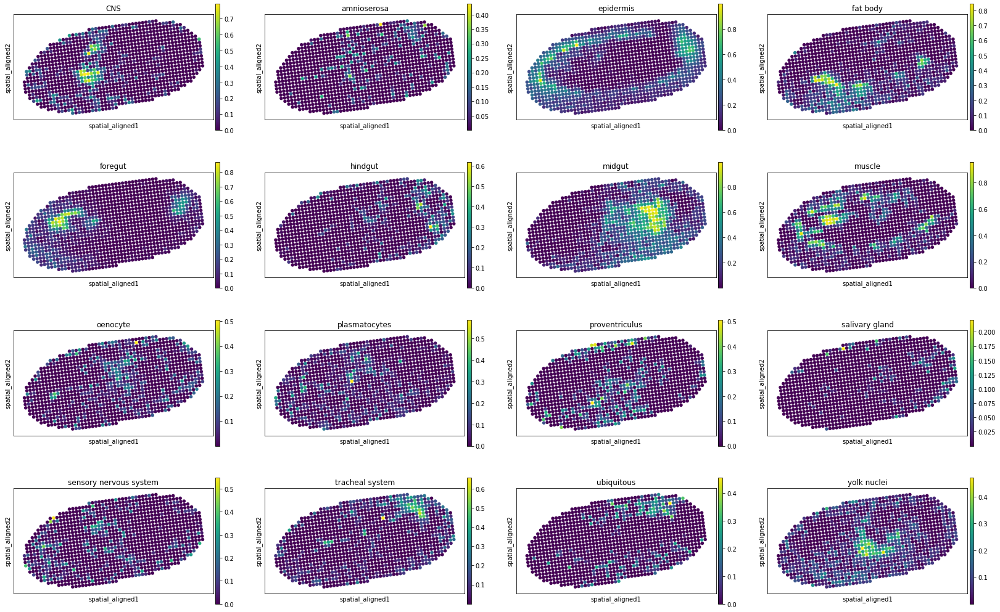

Slice 11


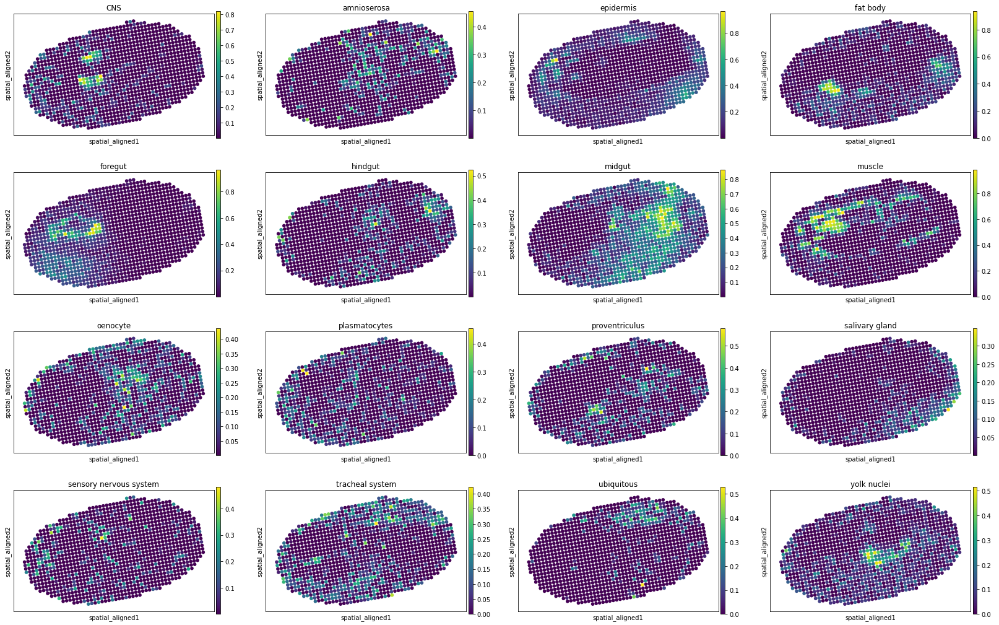

Slice 12


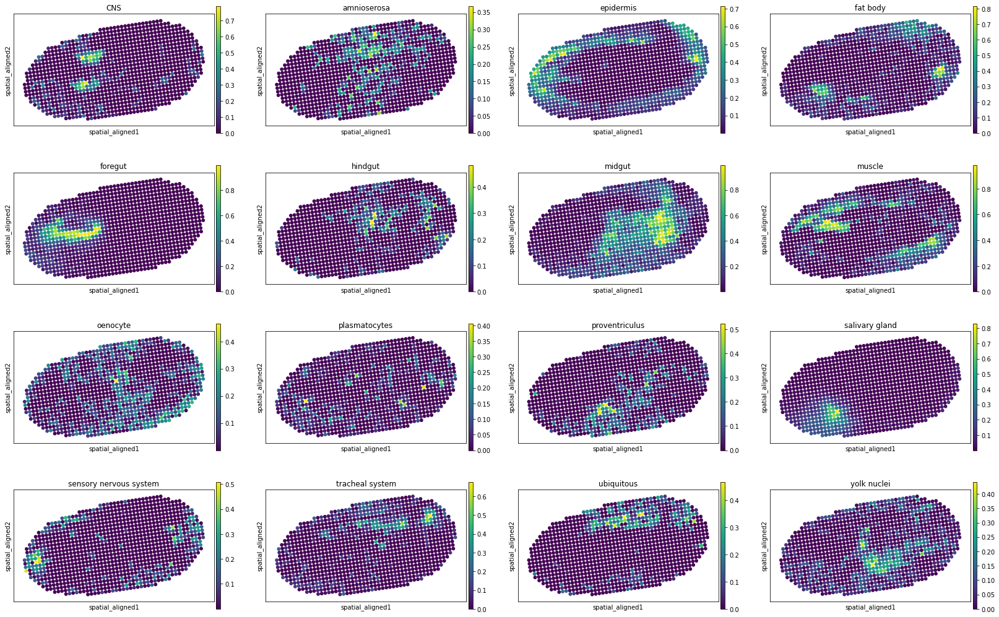

Slice 13


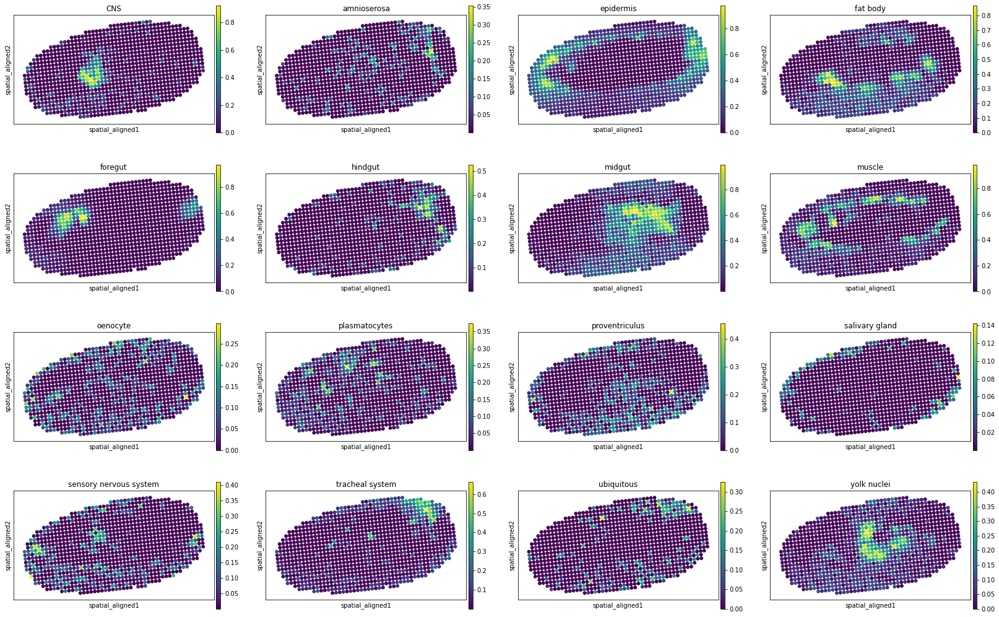

In [10]:
for i, adata_st_i in enumerate(result):
    print("Slice %d" % (i+1))
    sc.pl.spatial(adata_st_i, img_key="hires", basis="spatial_aligned", color=model.celltypes, spot_size=1.)